In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib
import asciitable
import pyfits
import os
import physical_scale_func as phys
import re
import csv

# Set Up 

In [2]:
PATH = '/Users/Roozbeh/Desktop/Work/Paper3/V2/'
candels = asciitable.read(PATH + 'SM/initial_conditions.csv')

singleSer = pd.read_csv(PATH + 'SM/1comp.csv')
singleSer['re_kpc'] = singleSer['re_kpc']*np.sqrt(1-singleSer['e'])

twoComp = pd.read_csv(PATH + 'SM/2comp.csv')
galfit_path = "/Users/Roozbeh/Desktop/Work/Old_Projects/Software/galfit"

header = ['Name','SN','z','mass','U','V','J','SF1_Quies0','SFH','x','y',\
          'Re_1d','re','re_kpc','Mag_1d','mag','n_init','n','e_1d','e',\
          'PA_1d','PA','sky_1ser','chi2_1ser','fitGoodness','note'] 

# Helper Function 

### Creating the GALFIT feedme File 

In [3]:
def create_galfit_readinFile(imageName, n_fixORfree, cat=candels,\
                             pixel_scale=0.06, label='1ser', magzpt=26):
    """
    creates the text file that can be fed to galfit
    """
    
    ## Finding the object in the catalogue
    galaxy = cat[cat['Name'] == imageName]
    galaxy = pd.DataFrame(galaxy)
    print imageName, 'SF1_Quie0: ' + str(make_float(galaxy['SF1_Quies0']))
    
    ## Using ELLIPSE runs for finding initial conditions
    sanity_check = raw_input('Happy with Re0:' + str(make_float(galaxy['Re_1d'])) + ':  ')
    if sanity_check.lower() == 'no':
        Re = raw_input('initial Re? ')
    else:
        Re = make_float(galaxy['Re_1d'])
        
    sanity_check = raw_input('Happy with Mag0:' + str(make_float(galaxy['Mag_1d'])) + ':  ')
    if sanity_check.lower() == 'no':
        mag = raw_input('initial Mag? ')
    else:
        mag = make_float(galaxy['Mag_1d'])        
    
    n = raw_input('initial n? ')

    sanity_check = raw_input('Happy with e0:' + str(make_float(galaxy['e_1d'])) + ':  ')
    if sanity_check.lower() == 'no':
        e = raw_input('initial e? ')
    else:
        e = make_float(galaxy['e_1d'])    
    
    sanity_check = raw_input('Happy with PA0:' + str(make_float(galaxy['PA_1d'])) + ':  ')
    if sanity_check.lower() == 'no':
        PA = raw_input('initial PA? ')
    else:
        PA = make_float(galaxy['PA_1d'])     
    
    z = make_float(galaxy['z'])
    
    ## Finding the corresponsing PSF
    if '_gs' in imageName: psf = 'gs_psf'
    elif 'uds' in imageName: psf = 'uds_psf'
    elif 'cosmos' in imageName: psf = 'cosmos_psf'
    elif '_egs' in imageName: psf = 'egs_psf'
    elif '_gn' in imageName: psf = 'gn_psf'

    ## Using lower/upper limits if the estimates are poor
    if Re > 10:  
        if z < 1:
            Re = 10
        elif 1 < z < 2:
            Re = 5
        else:
            Re = 2
            
    if mag > 25: mag = 25
    if mag < 18: mag = 18
    if e > 0.7: e = 0.7

    img_size = len(pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')[0].data)
    
    feedme = open(PATH + 'Read/1comp/' + imageName[:-4] + '_' + label + '.read','w')

    feedme.writelines('================================================================================\n'
    'A) ' + PATH + 'Fits/Sample/FINE/' + imageName + '.fit ' + '                 # Output data image block \n' 
    'B) ' + PATH + 'Fits/1comp/' + imageName[:-4] + '_' + label + '.fit' + ' # Output data image block \n'
    'C) ' + PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_rms.fits' + '  # Sigma image name  \n'
    'D) ' + PATH + 'psf/' +  psf  +   '.fits' + '                       # Input PSF image and kernel \n'
    'E) 1                                                               # PSF fine sampling factor relative to data \n'
    'F) ' + PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_mm.fits' + ' # Bad pixel mask (\n'
    'G) none                                                            # File with parameter constraints \n'
    'H) 1  ' + str(img_size) + '   1  ' + str(img_size) + '     # Image region to fit (xmin xmax ymin ymax) \n'
    'I) ' + str(img_size) + '    ' + str(img_size) + '          # Size of the convolution box (x y) \n'
    'J)   ' + str(magzpt) +  '                                  # Magnitude photometric zeropoint \n'
    'K) ' + str(pixel_scale) + ' ' + str(pixel_scale) + '       # Plate scale (dx dy)   [arcsec per pixel] \n'
    'O) regular                                                 # Display type (regular, curses, both) \n'
    'P) 0                                               # Options: 0=normal run; 1,2=make model/imgblock & quit \n\n'
    '0) sersic              # Object type\n'
    '1) ' + str(img_size/2 + 1) + ' ' + str(img_size/2) + ' 1  1          # Object coordinate  \n'
    '3) ' + str(mag) + '    1                                   # total magnitude \n'
    '4) ' + str(Re) + '     1                                   # R_e    [Pixels] \n'
    '5) ' + str(n) + '  ' + str(n_fixORfree) + '                # Sersic exponent (deVauc=4, expdisk=1) \n'
    '9) ' + str(1-e) + '      1                                 # axis ratio (b/a) \n'
    '10) ' + str(PA) + '    1                                   # position angle (PA)  [Degrees: Up=0, Left=90] \n'
    'Z) 0                                                       # Skip this model in output image?  (yes=1, no=0) \n\n'
    '0) sky                                                     # Component type \n'
    '1) 0     1                                                 # Sky background at center of fitting region [ADUs] \n'
    '2) 0     1                                                 # dsky/dx (sky gradient in x)     [ADUs/pix] \n'
    '3) 0     1                                                 # dsky/dy (sky gradient in y)     [ADUs/pix] \n'
    'Z) 0                                                       # Skip this model in output image?  (yes=1, no=0) \n'
    )

    feedme.close()
    
    return

### Running GALFIT

In [4]:
def run_galfit(imageName,n_fixORfree,label='1ser'):
    """
    simply runs galfit
    """
    
    print
    print
    create_galfit_readinFile(imageName,n_fixORfree=n_fixORfree)
    os.system(galfit_path + '   ' + PATH + 'Read/1comp/' + imageName[:-4] + '_' + label + '.read')
    os.system('rm  ' + PATH + 'Read/1comp/' + imageName[:-4] + '_' + label + '.read') 
    os.system('mv galfit.01 ' + PATH + 'Read/1comp/' + imageName[:-4] + '_' + label + '.read')

### Estimating S/N 

In [5]:
def measure_background_sigma(imageName):
    """
    Purpose: finding backgroun sigma
    by making a list of all background pixels and find its standard deviation
    """
    
    image_size = len(pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')[0].data)
    mm_image =  pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_mm.fits')   
    mm_pixels = mm_image[0].data
    
    pixelValues = []
    sky = pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')
    bkg_pixel = sky[0].data

    for axis1 in range(len(mm_pixels)):
        for axis2 in range(len(mm_pixels[0])):
            if mm_pixels[axis1,axis2] == 0:
                # and not near the center (i.e., galaxy)
                if axis1 not in range(int(image_size/2)-50, int(image_size/2)+50) and\
                   axis2 not in range(int(image_size/2)-50, int(image_size/2)+50):
                        pixelValues.append(bkg_pixel[axis1,axis2])

    STD = np.std(pixelValues)    
    return STD

In [6]:
def signal_to_noise(mag,sma,e,std,magzpt=26):
    """
    Purpose: measuring signal to noise
    
    input:
        mag = magnitude
        sma = semi-major axis
        e = ellipticity
        std = background noise
        magzpt = magnitude zeropoint
    """
    
    area = np.pi * sma**2 * (1-e)
    flux = 10**(0.4*(magzpt - mag))
    SN = flux / np.sqrt(flux + area * std**2)
    return np.sqrt(3300)*SN

### Create a Catalogue Entry  

In [7]:
def build_catalogue_entry(imageName,n_fixORfree,label='1ser',cat=candels):
    """
    for building catalogue
    """

    gal = cat[cat['Name'] == imageName]
    galaxy = pd.DataFrame(gal)

    ## Measured Values Using 1D (ELLIPSE)
    Re = make_float(galaxy['Re_1d'])
    mag = make_float(galaxy['Mag_1d'])
    n = 1
    e = make_float(galaxy['e_1d'])
    PA = make_float(galaxy['PA_1d'])
    
    z, mass = make_float(galaxy['z']), make_float(galaxy['mass'])
    ## Taking care of inconsistent formats of CANDELS catalogues
    if mass > 1000: 
        mass = np.log10(mass)

        
    U, V, J = make_float(galaxy['U']), make_float(galaxy['V']), make_float(galaxy['J'])
    SF_class, SFH = make_float(galaxy['SF1_Quies0']), make_float(galaxy['SFH'])
    std = measure_background_sigma(imageName)
    
    
    try:
        gal_output = open(PATH + 'Read/1comp/' + imageName[:-4] + '_' + label + '.read','r')
        oneSer = gal_output.readlines()
        gal_output.close()
                
        x = float(re.search(r'([\w.]+)\s+([\w.]+)',oneSer[40]).group(1))
        y = float(re.search(r'([\w.]+)\s+([\w.]+)',oneSer[40]).group(2))
        re_1ser = float(re.search(r'([\w.]+)\s+(1)',oneSer[42]).group(1))
        Re_kpc =  physical_size(re_1ser,z)
        mag_1ser = float(re.search(r'([\w.]+)\s+(1)',oneSer[41]).group(1))
        n_1ser = float(re.search(r'([\w.]+)\s+('+str(n_fixORfree)+')',oneSer[43]).group(1))
        e_1ser = 1 - float(re.search(r'([\w.]+)\s+(1)',oneSer[47]).group(1))
        PA_1ser = float(re.search(r'([\w.]+)\s+(1)',oneSer[48]).group(1))
        chi2_1ser = float(re.search(r'[\w\^\/]+\s=\s([\w.]+)', oneSer[3]).group(1))
        #sky & S/N
        sky_1ser = float(re.search(r'([\w.-]+)\s+(1)',oneSer[53]).group(1))
        SN = signal_to_noise(mag_1ser,re_1ser,e_1ser,std)
        
        output = [imageName] + map(round3,[SN,z,mass,U,V,J]) + [SF_class,SFH] + \
                map(round3, [x, y, Re,re_1ser,Re_kpc,mag,mag_1ser,\
                n,n_1ser,e,e_1ser,PA,PA_1ser]) + [sky_1ser, chi2_1ser]
       
        print 
        print 'GALFIT Estimates','Re(kpc)=', Re_kpc, ' n=', n_1ser, ' z=', z, \
              ' SF_CLASS=', SF_class 
        print 
        print 'Catalogue Entry'
        return output
        
    except:
        #raise Exception('GALFIT Failed To Fit A Model')
        print 'GALFIT Failed To Fit A Model'
        pass

### Update Catalogue 

In [8]:
def write_catalogue(data_list,CatName='1comp.csv'):
    """
    write the catalogue to a CSV file
    """
    
    ## For the first run, only header is written
    if data_list == header and CatName not in os.listdir(PATH + '/SM/'):
        models_results = open(PATH + "SM/" + CatName, "w")
        write_pattern = csv.writer(models_results)
        write_pattern.writerow(data_list)
        models_results.close()

    elif data_list != header:
        currectCat = pd.read_csv(PATH + "SM/" + CatName)
        if data_list[0] in currectCat.Name.values:
            return
        models_results = open(PATH + "SM/" + CatName, "a")
        write_pattern = csv.writer(models_results)
        write_pattern.writerow(data_list)
        models_results.close() 

### Find The Best Model Fit 

In [9]:
def findBest(imageName, n_fixORfree=1, label='1ser'):
    """
    finding the model fit based on different initial conditions, interactively
    """
    
    run_galfit(imageName, n_fixORfree=n_fixORfree, label='1ser')
    
    ## Checking the GOODNESS of the fit
    entry = build_catalogue_entry(imageName, n_fixORfree=n_fixORfree)
    os.system('ds9 -multiframe -scale log ' + PATH + 'Fits/1comp/' + imageName[:-4] + '_' + label + '.fit &')
    
    ## Using Surface Brightness Diagnostic
    construct_subComponent(imageName)
    e0, PA0 = entry[19], entry[21]
    ellipse(imageName,e0=e0,PA0=PA0,Type='galaxy')
    ellipse(imageName,e0=e0,PA0=PA0,Type='model')
    tdump(imageName,Type='galaxy')
    tdump(imageName,Type='model')
    plot_diagnostic(imageName)
    response = raw_input('Happy With Output? (yes/no):  ')

    if response.lower() == 'no':
        findBest(imageName, n_fixORfree=int(raw_input('n_fixORfree?')))
    elif response.lower() == 'yes':
        fitGoodness = raw_input('Goodness of the fit? (high/inter/low):  ')  
        note = raw_input('note:  ') 
        write_catalogue(list(build_catalogue_entry(imageName,n_fixORfree=n_fixORfree)) + [fitGoodness,note])
    else:
        raise 'Unknow Reponse (yes or no?)'

### Misc. Functions 

In [10]:
def round3(x):
    return round(x,3)

def make_float(parameter):
    if type(parameter) != float:
        return float(parameter[0])
    else:
        return parameter

def physical_size(Re,z,pix_scale=0.06):
    return Re*phys.physical_scale(z)*pix_scale

## Diagnostic Graphs

### Constructing Image of Each Object: galaxy/model/bulge/disk 

In [11]:
def construct_subComponent(imageName, Directory='1comp'):
    """
    Create a FITS file which contains only Bulge or Disk component
    """
    
    # Finding the size of the image
    image_size = len(pyfits.open(PATH + 'Fits/' + Directory + '/' + imageName[:-3] + '1ser.fit')[2].data)    
    
    # Creating the subcompents image
    os.system(galfit_path + ' -o3 ' + PATH + 'Read/' +  Directory + '/' + imageName[:-3] + '1ser.read')
    subComp = pyfits.open('subcomps.fits')
    
    
    if imageName[:-3] + '1ser_galaxy.fit' not in os.listdir(PATH  + 'Fits/' + Directory +'/'):        
        ZeroArray = np.zeros([image_size,image_size])
        canvas1 = pyfits.PrimaryHDU(ZeroArray)
        canvas_galaxy = canvas1.data
        canvas_galaxy += subComp[0].data - subComp[2].data
        canvas1.data = canvas_galaxy
        canvas1.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '1ser_galaxy.fit')

    if imageName[:-3] + '1ser_model.fit' in os.listdir(PATH  + 'Fits/' + Directory +'/'):
        # If there is already a model galaxy, we need to remove it first
        os.system('rm ' + PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '1ser_model.fit')
        
    ZeroArray = np.zeros([image_size,image_size])
    canvas2 = pyfits.PrimaryHDU(ZeroArray)
    canvas_model = canvas2.data
    canvas_model += subComp[1].data - subComp[2].data
    canvas2.data = canvas_model
    canvas2.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '1ser_model.fit')

### Constructing Surface Brightness Profile Using ELLIPSE   

In [12]:
def ellipse(imageName, e0, PA0, Type, Directory='1comp',\
            hold_e='yes', hold_PA='yes', magzpt=26, step_size=0.04):
    """
    Baically does what ELLIPSE/IRAF does but have limited options for editing
    """

    # Remove the result from the previouse run
    if imageName[:-3] + '1ser' + '_' + Type + '.bin' in os.listdir(PATH + '1D/'):
        os.system('rm ' + PATH + '1D/' + imageName[:-3] + '1ser' + '_' + Type + '.bin')
        os.system('rm ' + PATH + '1D/' + imageName[:-3] + '1ser' + '_' + Type + '.dat')
    
    # Creating the parameter file for ELLIPSE
    fp = open(PATH + '/Par/ellipse.par','r')
    ellipse_par = fp.readlines()
    fp.close()  

    if Type.lower() == 'galaxy': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '1ser_galaxy.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/1comp/' + imageName[:-3] + '1ser_galaxy.fit' + '\n'
    elif Type.lower() == 'model': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '1ser_model.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/1comp/' + imageName[:-3] + '1ser_model.fit' + '\n'
    elif Type.lower() == 'unconv':
        image_size = len(pyfits.open(PATH + 'Fits/1comp/' + imageName[:-3] + '1ser_unconv.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/1comp/' + imageName[:-3] + '1ser_unconv.fit' + '\n'
        
    ellipse_par[1] = 'ellipse.output = ' + PATH + '1D/' + imageName[:-3] + '1ser' + '_' + Type + '.bin' + '\n'
    ellipse_par[2] = 'geompar.x0= ' + str(image_size/2) + '\n'
    ellipse_par[3] = 'geompar.y0= ' + str(image_size/2) + '\n'
    ellipse_par[4] = 'geompar.ellip0 = ' + str(e0) + '\n'
    ellipse_par[5] = 'geompar.pa0 = ' + str(PA0) + '\n'
    ellipse_par[6] = 'magpar.mag0 = ' + str(magzpt) + '\n'
    ellipse_par[7] = 'geompar.maxsma = ' + str(image_size/2) + '\n'
    ellipse_par[8] = 'controlpar.hellip = ' + str(hold_e) + '        \n'
    ellipse_par[9] = 'controlpar.hpa = ' + str(hold_PA) + '           \n'
    ellipse_par[10] = 'geompar.step = ' + str(step_size) + '          \n' 
   
    output = open(PATH + '/Par/ellipse' + imageName + '.par','w')
    output.writelines(ellipse_par)
    output.close()  
    
    # Running ELLIPSE
    os.system('/usr/stsci/stsci_iraf-3.14/stsdas/bin.macintel/x_isophote.e \
               ellipse @' + PATH + '/Par/ellipse' + imageName + '.par')

    # Removing the parameter file
    os.system('rm ' + PATH + '/Par/ellipse' + imageName + '.par')

In [13]:
def tdump(imageName, Type):
    """
    Baically does what Tdump/IRAF does
    """  
    
    # Creating the parameter file for Tdump
    ff = open(PATH + '/Par/tdump.par','r')
    tdump_param = ff.readlines()
    ff.close()
    
    tdump_param[0] = 'tdump.table = ' +  PATH + '1D/' + imageName[:-3] + '1ser' + '_' + Type + '.bin' + '\n'
    tdump_param[3] = 'tdump.datafile = ' +  PATH + '1D/' + imageName[:-3] + '1ser' + '_' + Type + '.dat' + '\n'
    
    output = open(PATH + '/Par/tdump' + imageName + '.par','w')
    output.writelines(tdump_param)
    output.close()
    
    # Running Tdump and removing the parameter file
    os.system('/usr/stsci/stsci_iraf-3.14/tables/bin.macintel/x_ttools.e \
                tdump @' + PATH + '/Par/tdump' + imageName + '.par')  
    os.system('rm ' + PATH + '/Par/tdump' + imageName + '.par')             

### Plotting The Surface Brightness For Checking The Goodness of The Fit  

In [39]:
def plot_diagnostic(imageName):
    """
    Constructing the good-old surface brightness profile!
    """

    #################################################
    ###### Finding the galaxy catalogue entry #######
    #################################################

    cat = singleSer[singleSer.Name == imageName]
    
    ##################################
    ###### Basic Figure Set up #######
    ##################################   
    
    plt.rcdefaults()
    #plt.style.use('ggplot')
    fig = plt.figure(figsize=(10, 8),frameon=False) 
    gs = gridspec.GridSpec(3,3)    ## Creating space for subplots
    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0    
    
    #####################################################
    ###### Reading the data and calculating error #######
    #####################################################

    ### Reading All The Files
    galaxy = asciitable.read(PATH + '1D/' + imageName[:-3] + '1ser_galaxy.dat')
    model = asciitable.read(PATH + '1D/' + imageName[:-3] + '1ser_model.dat')
    
    galaxy_img = pyfits.getdata(PATH + 'Fits/1comp/' + imageName[:-3] + '1ser_galaxy.fit')
    model_img = pyfits.getdata(PATH + 'Fits/1comp/' + imageName[:-3] + '1ser_model.fit')
    resid_img = pyfits.open(PATH + '/Fits/1comp/' + imageName[:-3] + '1ser.fit')[3].data
    image_size = len(galaxy_img)    
    
    ### Converting Flux to Surface Brightness
    SMA_galaxy = galaxy['col1']*0.06
    mu_galaxy = -2.5*np.log10(galaxy['col2']/(0.06*0.06)) + 26
    mu_model = -2.5*np.log10(model['col2']/(0.06*0.06)) + 26
    mu_diff = mu_model - mu_galaxy
        
    ### Calculating the total error
    bkg_err = measure_background_sigma(imageName)
    galaxy_err = np.sqrt(np.square(galaxy['col3']) + bkg_err**2)
    model_err = model['col3']
    total_err = np.sqrt((galaxy_err/abs(galaxy['col2']))**2 + (model_err/abs(model['col2']))**2)
    errBar = 2.50 * np.log( 1.0 + total_err)

    ##############################################
    ######## Plot1 -- Surface Brightness #########
    ##############################################    
    
    ax1 = plt.subplot(gs[0:2,0:2])
    ax1.set_xscale('log') 
    
    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    
    ax1.scatter(SMA_galaxy,mu_galaxy, color='black', marker='o', label='Data')
    ax1.errorbar(SMA_galaxy,mu_galaxy, yerr=galaxy_err/abs(galaxy['col2']), color='black', marker='.', 
                 elinewidth = .3,linestyle='None', markerfacecolor='none', capthick=0.01)
    ax1.scatter(SMA_galaxy,mu_model, color='magenta', marker='.', label='Model')
    ax1.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax1.set_ylim([26.2,min(mu_galaxy)-.3])

    ##############################################
    ######### Adding Text (Galaxy Info) ##########
    ##############################################
    
    font = {'weight' : 'normal', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0
    
    ax1.annotate('$z = ' + str(round(float(cat['z']),1))+'$', xy=(0.05, 23.2), 
                 xytext=(.04, 23.2),fontsize=25)
    ax1.annotate('$M_{*} = ' + '10^{' + str(round(float(cat['mass']),1))+'}M_{\odot}$', 
                 xy=(0.05, 24.0), xytext=(.04, 24.0),fontsize=25)
    ax1.annotate('$R_e = ' + str(round(float(cat['re_kpc']),1))+'$ kpc', 
                 xy=(0.05, 24.8), xytext=(.04, 24.8),fontsize=25)
    ax1.annotate('$n = ' + str(round(float(cat['n']),1))+'$', 
                 xy=(0.05, 25.6), xytext=(.04, 25.6),fontsize=25)

    
    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0    
    
    ax1.legend(loc='upper right', numpoints=1, ncol=1, fontsize=18)
    ax1.set_ylabel('$\mu$ (mag acrsec$^{-2}$)',fontsize=30)    

    #####################################
    ######## Plot2 -- Residuals #########
    #####################################

    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0
    
    ax2 = plt.subplot(gs[2,0:2], sharex=ax1)
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2.set_xscale('log') 

    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    
    ax2.scatter(SMA_galaxy,mu_diff, color='magenta', marker='o', label='Data')
    ax2.errorbar(SMA_galaxy,mu_diff, yerr=errBar, color='black', marker='.', 
                 elinewidth = .3,linestyle='None', markerfacecolor='none', capthick=0.01)

    ax2.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax2.set_ylim([-.9,.9])
    
    ax2.set_xlabel('log(Semi Major Axis) (arcsec)',fontsize=25)
    ax2.set_ylabel('$\Delta \mu$',fontsize=30)    
    
    ##################################
    ######### FITS Files #############
    ##################################

    matplotlib.rcParams.update(matplotlib.rcParamsDefault)
    #plt.figure(frameon=False)
    ax3 = plt.subplot(gs[0,-1])
    ax3.set_frame_on(False)
    ax3.imshow(np.log(galaxy_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax3.axis('off')

    ax4 = plt.subplot(gs[1,-1])
    ax4.set_frame_on(False)
    ax4.imshow(np.log10(model_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax4.axis('off')

    ax5 = plt.subplot(gs[2,-1])
    ax5.set_frame_on(False)
    ax5.imshow(np.log(resid_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax5.axis('off')
    
    plt.tight_layout(h_pad=0.0001,w_pad=.0001)

    #plt.savefig(PATH + '1D/' + imageName[:-3] + '1ser_1D.ps')
    plt.savefig('/Users/Roozbeh/Desktop/work/Writings/Paper3/Diagnostic_Plots/' + 
                imageName[:-3] + '1ser_1D.jpg')
    
    #os.system('open ' + PATH + '1D/' + imageName[:-3] + '1ser_1D.jpg')
    #if imageName[:-3] + '2ser_1D.jpg' in os.listdir(PATH + '1D/'):
    #    os.system('open ' + PATH + '1D/' + imageName[:-3] + '2ser_1D.jpg')

In [40]:
plot_diagnostic('z1.5_m11.1_1372_uds_drz')
plot_diagnostic('z0.7_m11.1_13815.0_cosmos_drz')

# Single Sersic Fitting 

In [ ]:
%pylab qt
## For the first run only
#write_catalogue(header)

for gal in candels['Name']:    
    currectCat = pd.read_csv(PATH + "SM/1comp.csv")
    if gal in currectCat.Name.values:
        continue
    everyStep = raw_input('continue it or not? (yes/no): ')
    if everyStep.lower() == 'no':
        break
        
    print gal
    moveOn = raw_input('ingore this object? (yes/no): ')
    if moveOn.lower() == 'yes':
        continue
    else:
        findBest(gal)

Populating the interactive namespace from numpy and matplotlib
continue it or not? (yes/no): 
z2.1_m11.0_5563.0_gs_drz
ingore this object? (yes/no): 


z2.1_m11.0_5563.0_gs_drz SF1_Quie0: 1.0
Happy with Re0:81.956:  
Happy with Mag0:21.011:  
initial n? 2
Happy with e0:0.226:  
Happy with PA0:63.531:  


# New Diagnostic Plots 

/Users/Roozbeh/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


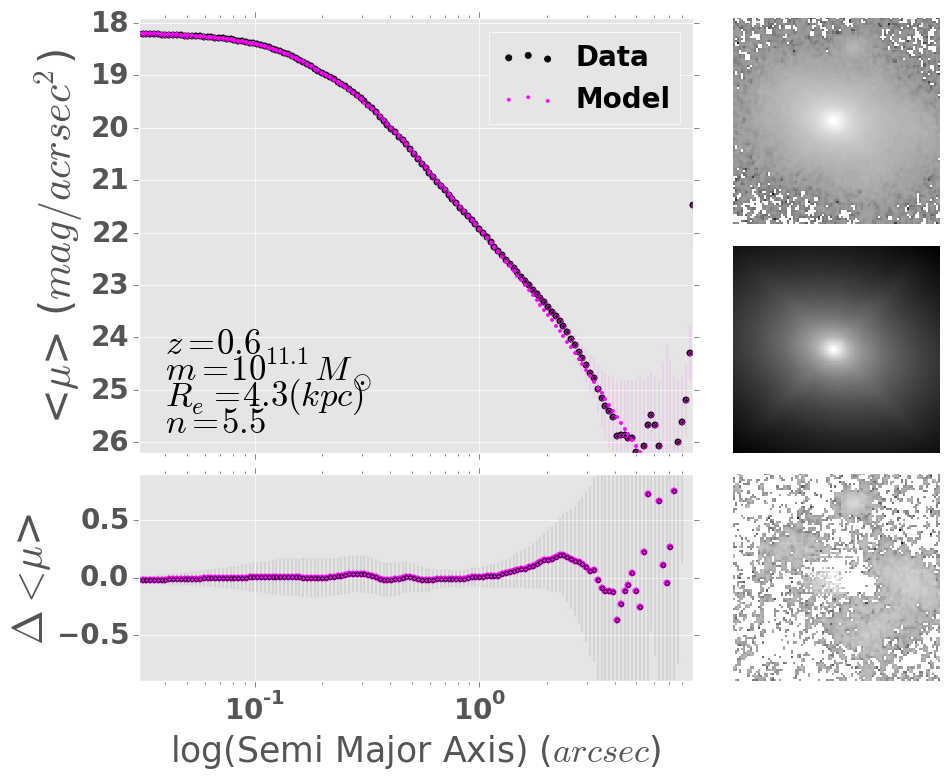

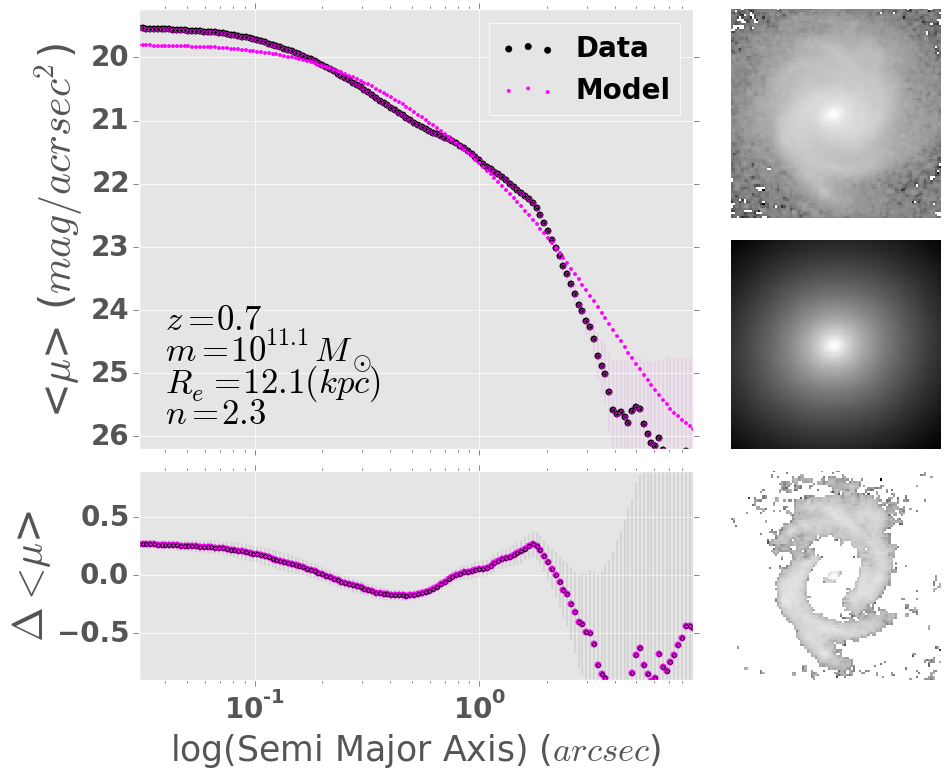

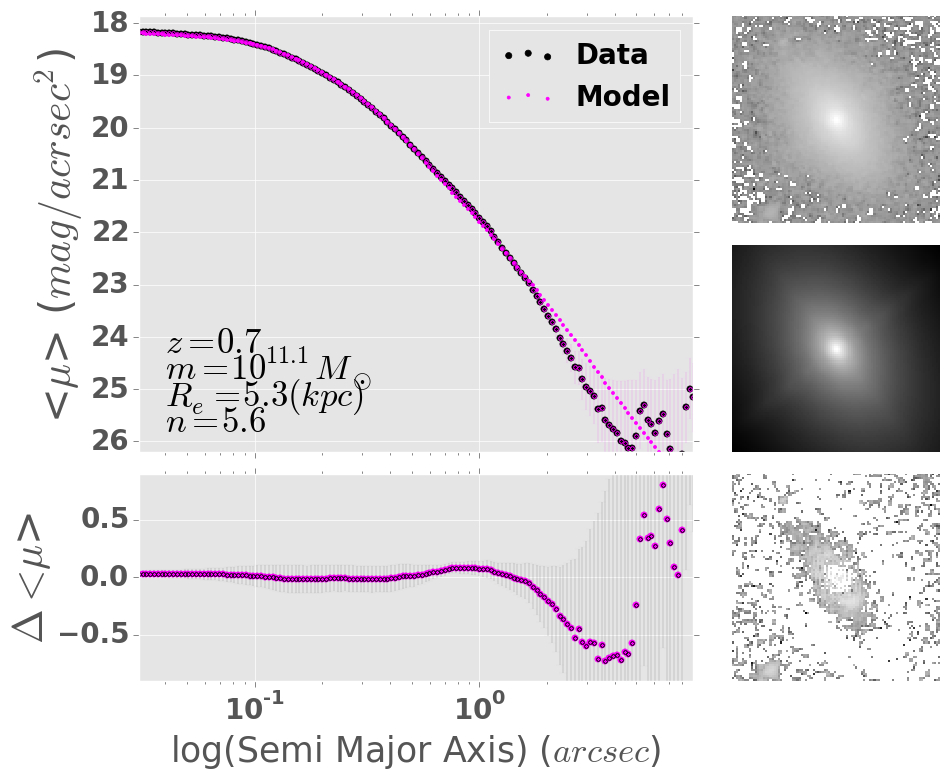

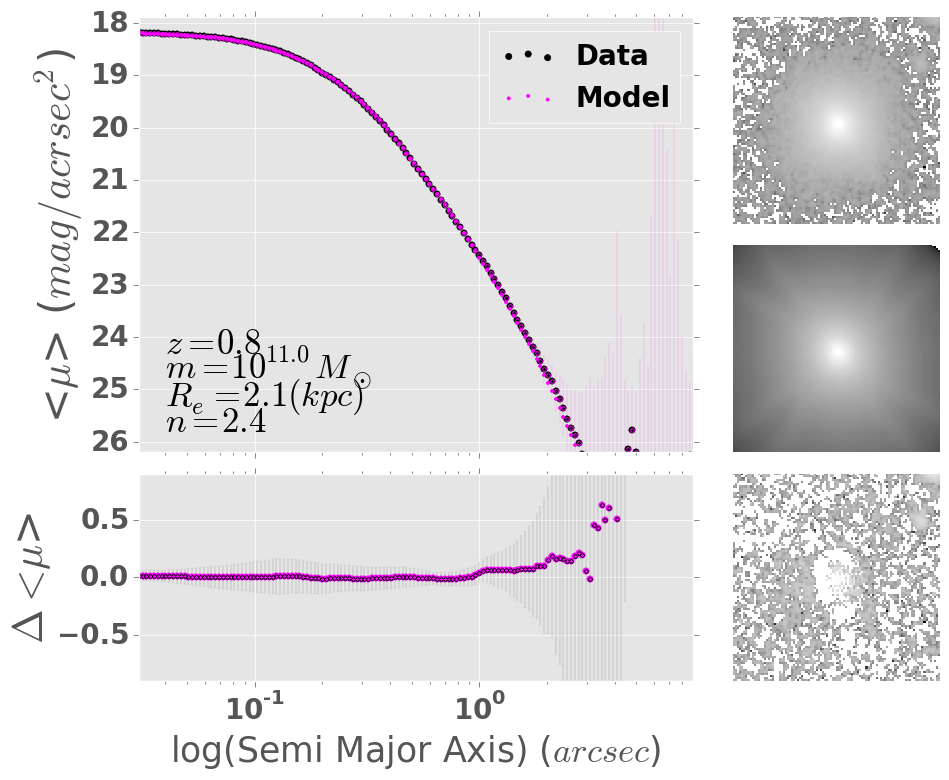

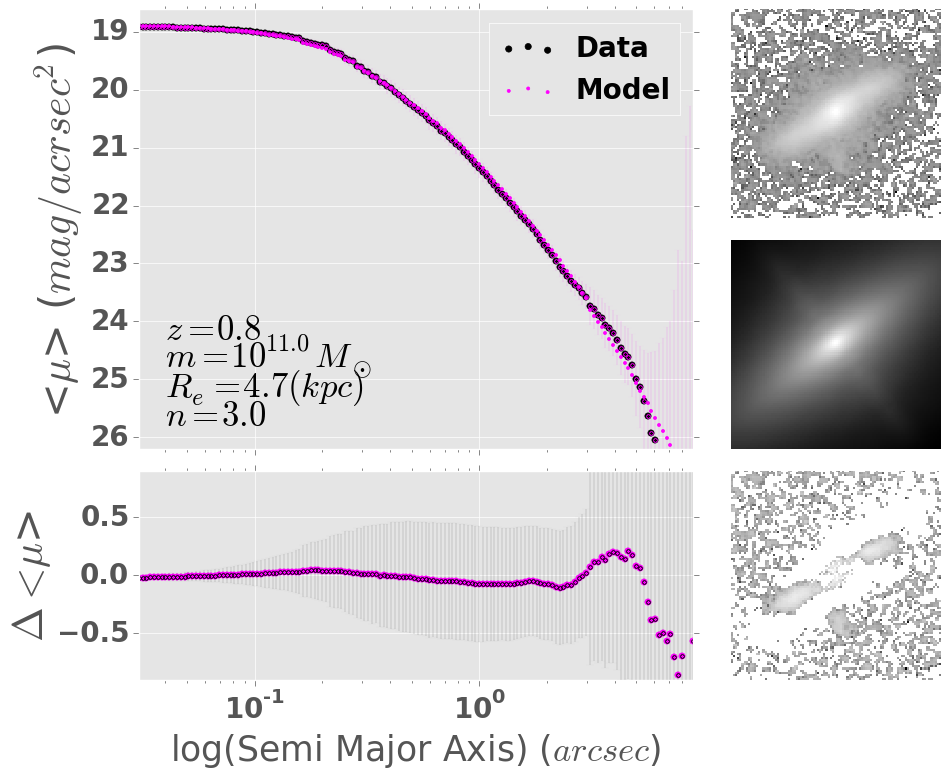

...

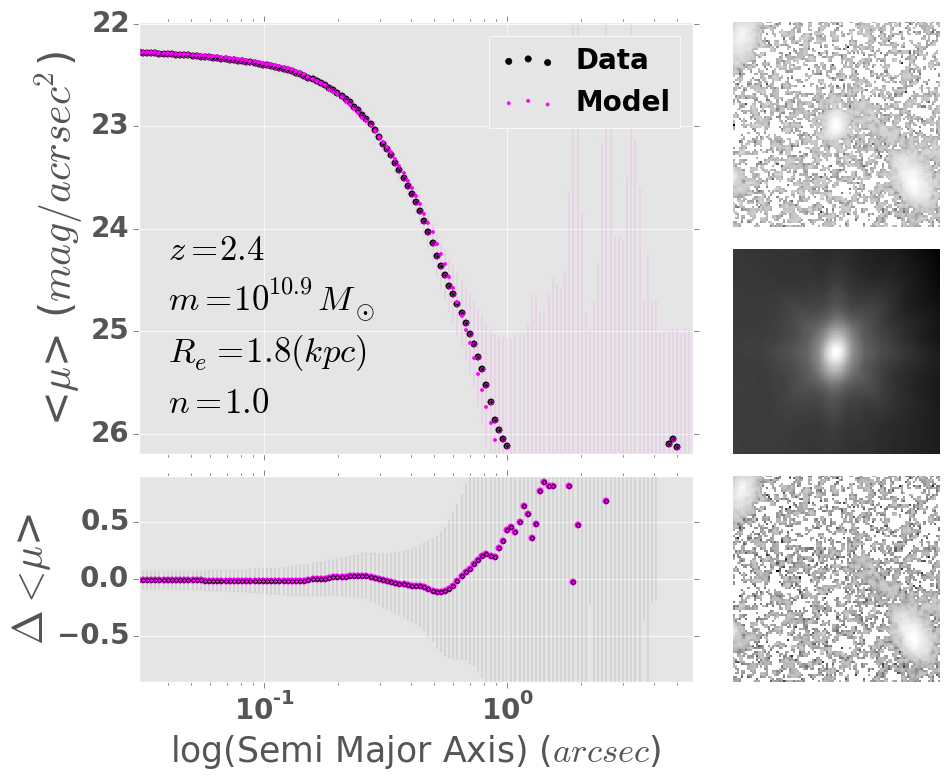

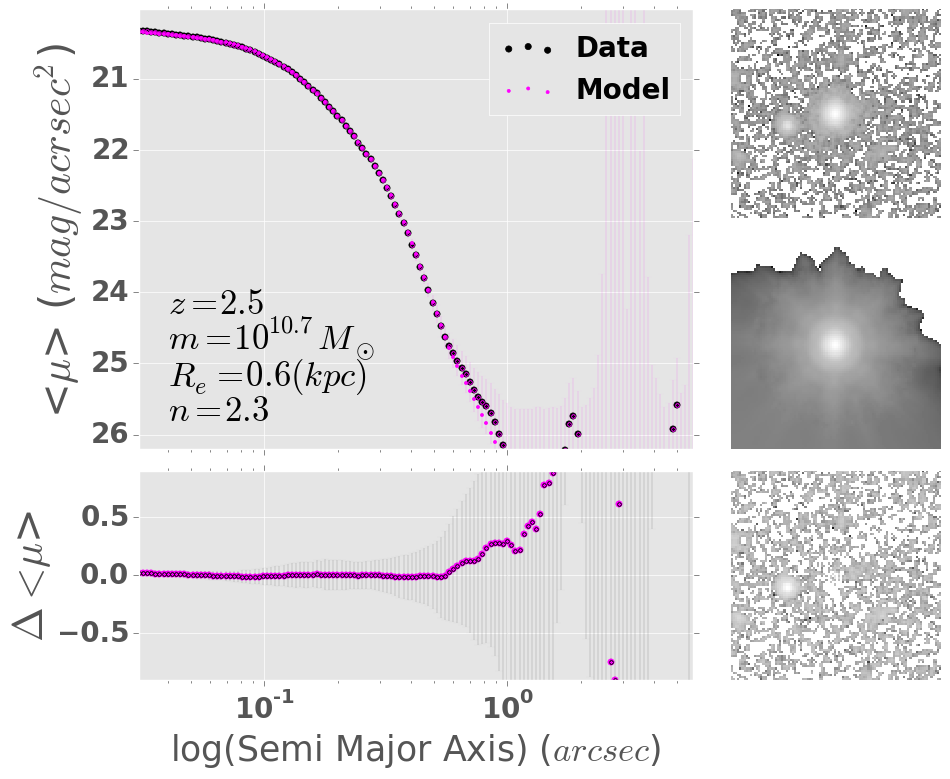

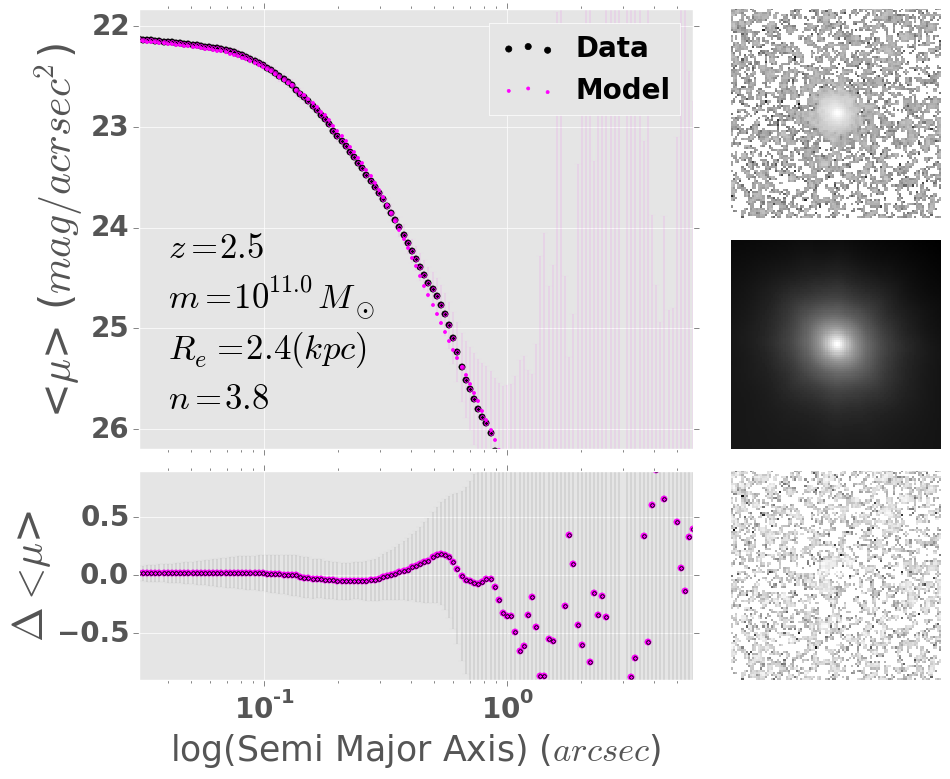

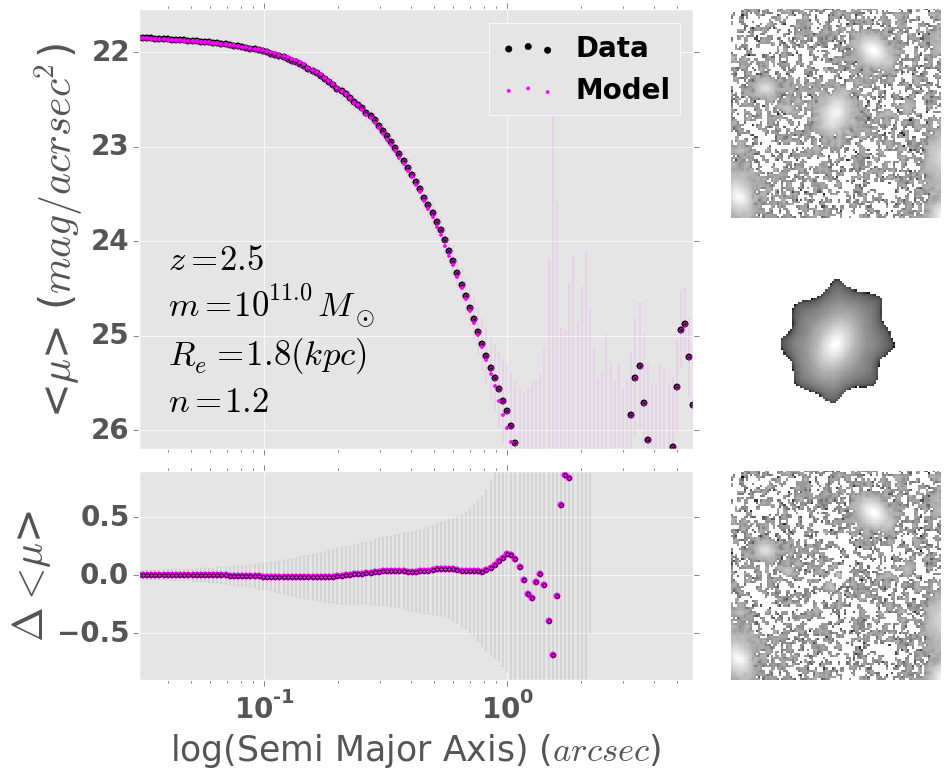

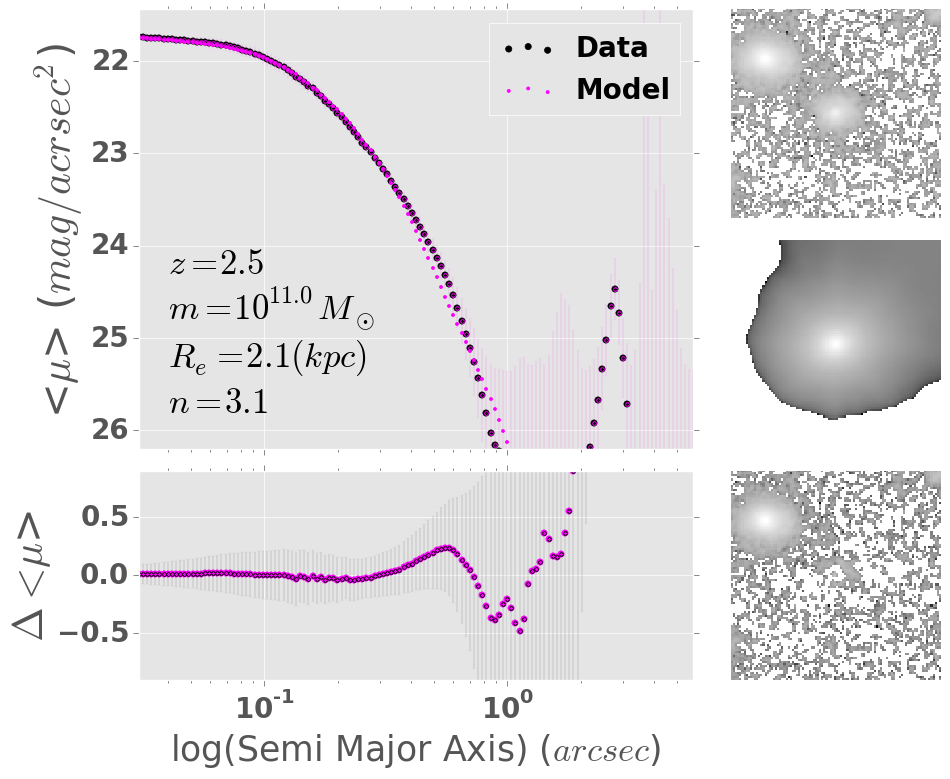

In [172]:
for Index in singleSer.index:
    
    # find the imageName
    imageName = singleSer.ix[Index].Name
    #cat = singleSer[singleSer.Name == imageName]
    #e0, PA0 = float(cat['e']), float(cat['PA'])
    #ellipse(imageName,e0=e0,PA0=PA0,Type='galaxy')
    #ellipse(imageName,e0=e0,PA0=PA0,Type='model')
    #tdump(imageName,Type='galaxy')
    #tdump(imageName,Type='model')
    plot_diagnostic(imageName)